Full image dimensions: 16091 x 18457

Band value ranges after scaling:
Green: 0.0000 to 0.1945
Red: 0.0000 to 0.1867
NIR: 0.0000 to 0.3470

Region of Interest: x(4100-13000), y(400-15000)
ROI dimensions: 14600 x 8900


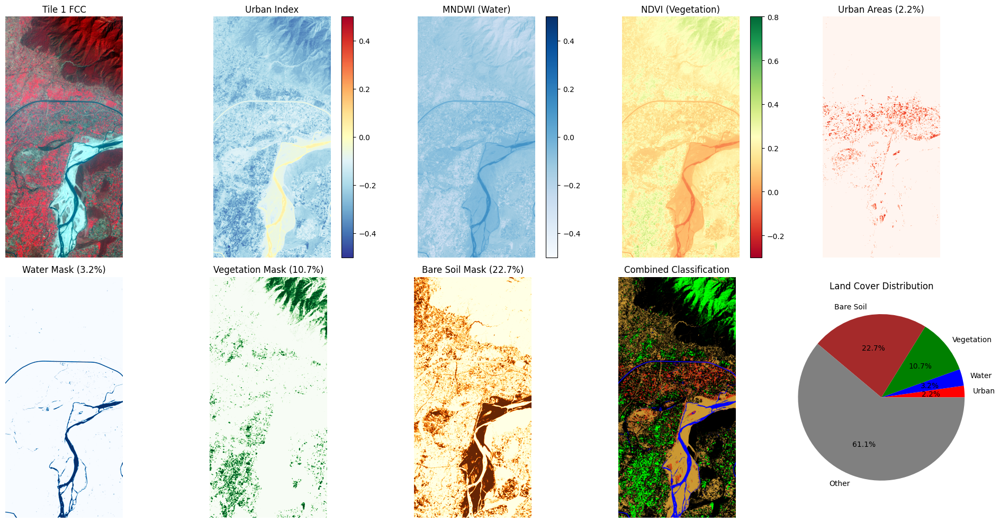


Tile 1 Statistics:
  Urban: 2.2%
  Water: 3.2%
  Vegetation: 10.7%
  Bare Soil: 22.7%
  Other: 61.1%


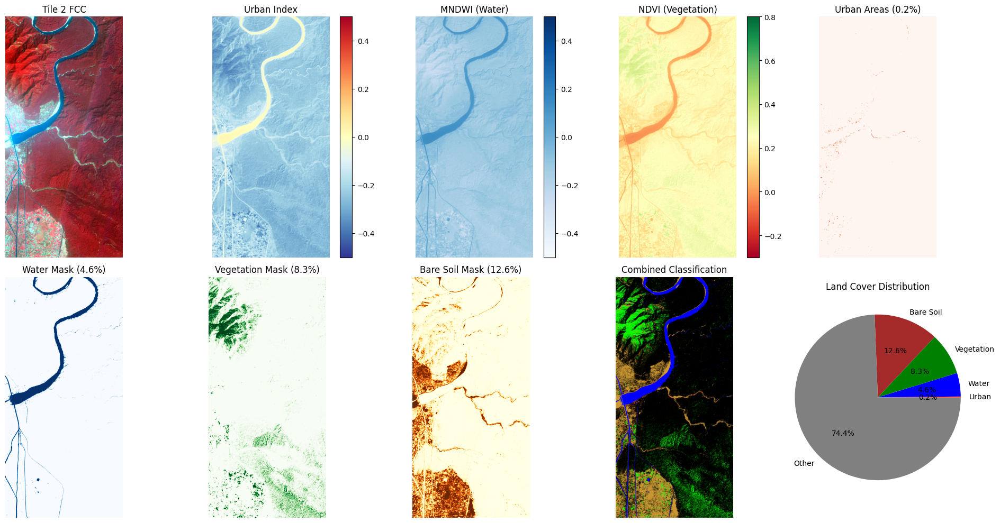


Tile 2 Statistics:
  Urban: 0.2%
  Water: 4.6%
  Vegetation: 8.3%
  Bare Soil: 12.6%
  Other: 74.4%


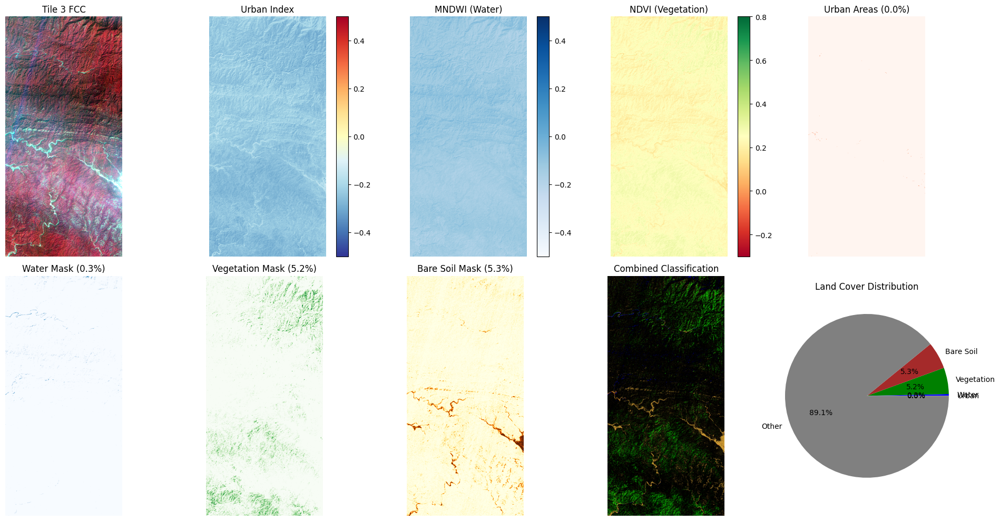


Tile 3 Statistics:
  Urban: 0.0%
  Water: 0.3%
  Vegetation: 5.2%
  Bare Soil: 5.3%
  Other: 89.1%


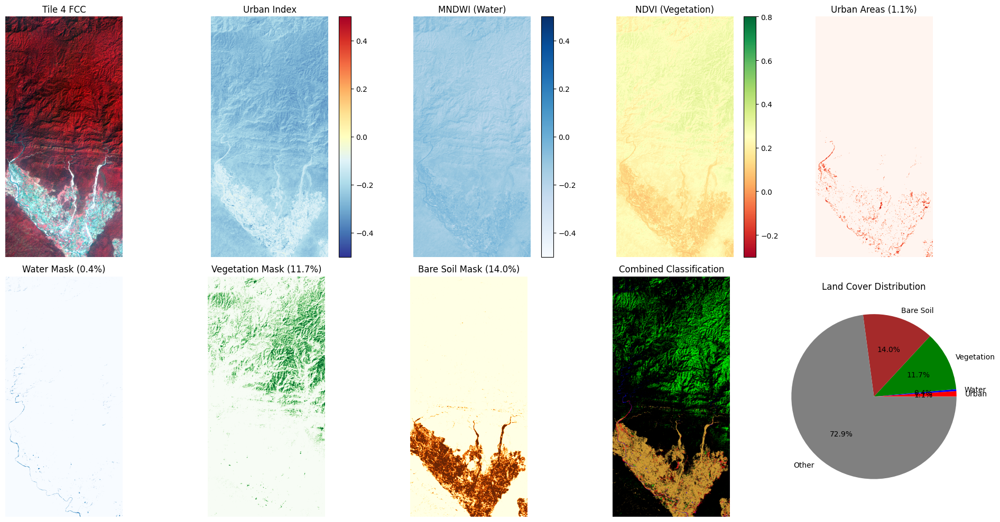


Tile 4 Statistics:
  Urban: 1.1%
  Water: 0.4%
  Vegetation: 11.7%
  Bare Soil: 14.0%
  Other: 72.9%


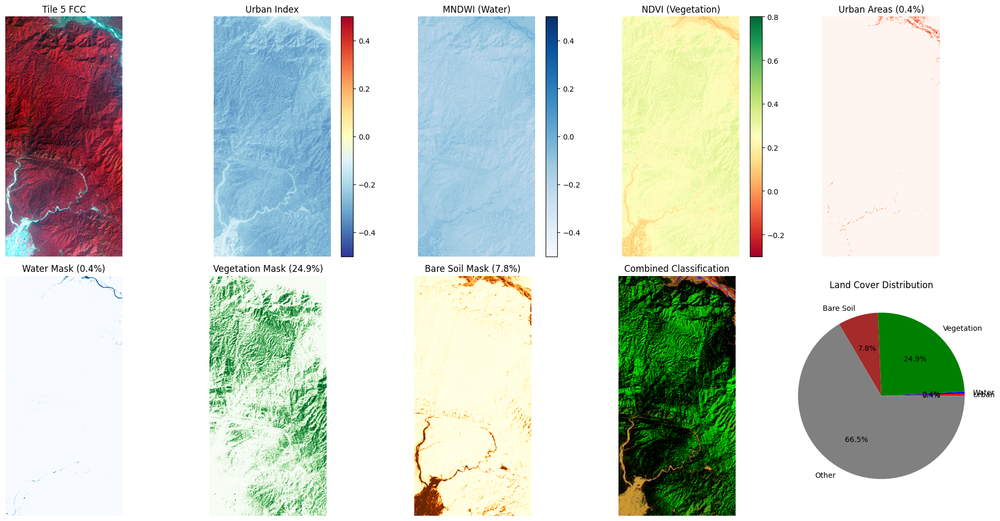


Tile 5 Statistics:
  Urban: 0.4%
  Water: 0.4%
  Vegetation: 24.9%
  Bare Soil: 7.8%
  Other: 66.5%


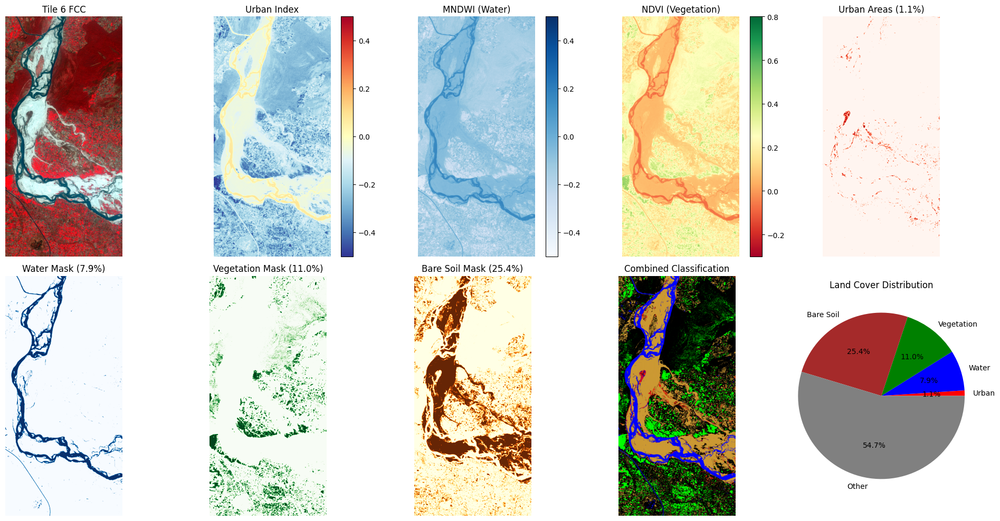


Tile 6 Statistics:
  Urban: 1.1%
  Water: 7.9%
  Vegetation: 11.0%
  Bare Soil: 25.4%
  Other: 54.7%


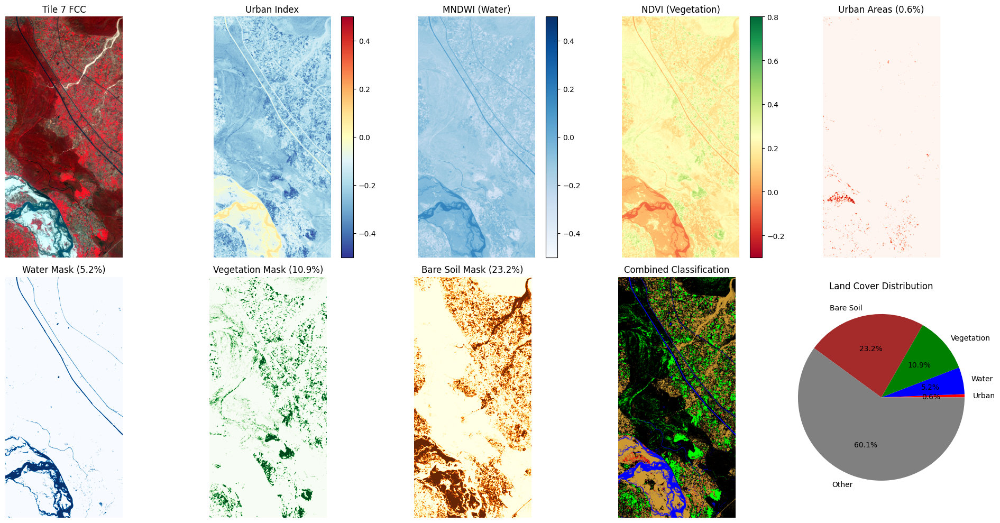


Tile 7 Statistics:
  Urban: 0.6%
  Water: 5.2%
  Vegetation: 10.9%
  Bare Soil: 23.2%
  Other: 60.1%


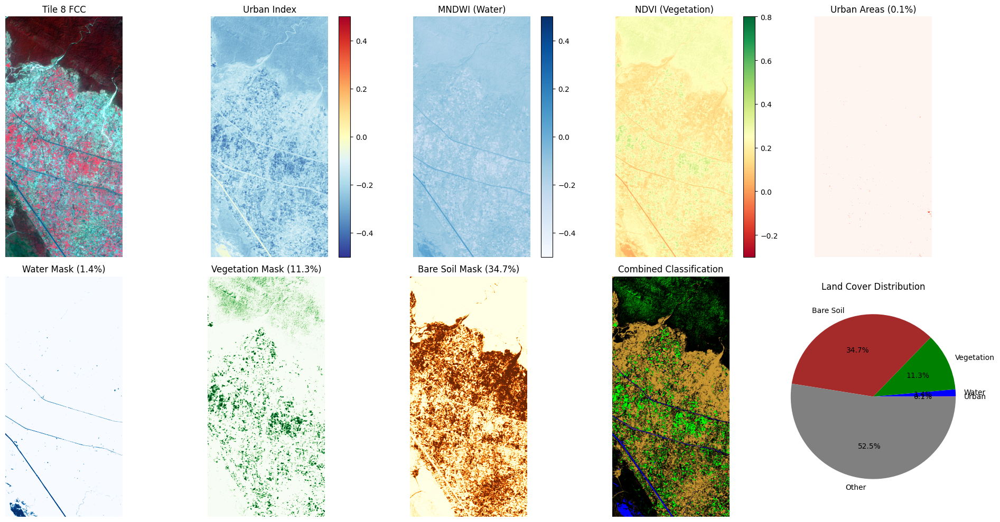


Tile 8 Statistics:
  Urban: 0.1%
  Water: 1.4%
  Vegetation: 11.3%
  Bare Soil: 34.7%
  Other: 52.5%


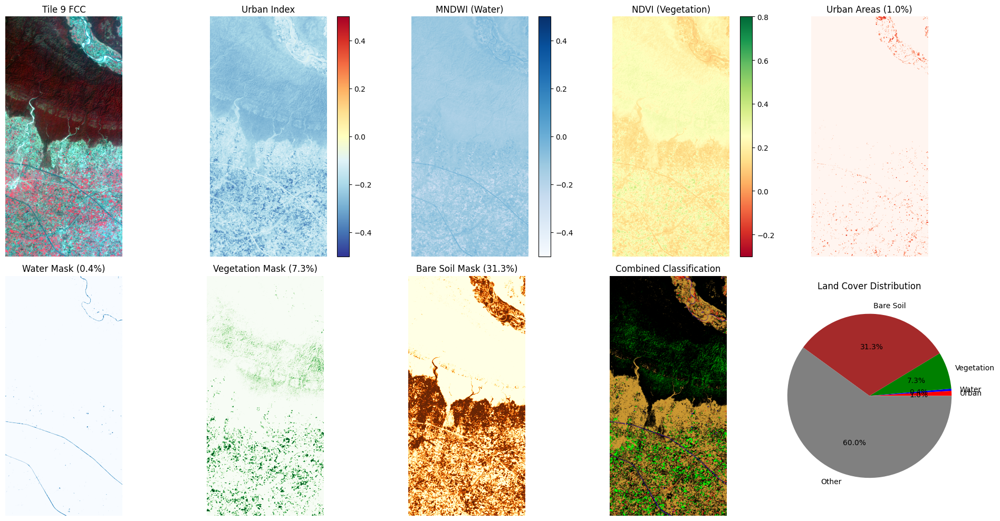


Tile 9 Statistics:
  Urban: 1.0%
  Water: 0.4%
  Vegetation: 7.3%
  Bare Soil: 31.3%
  Other: 60.0%


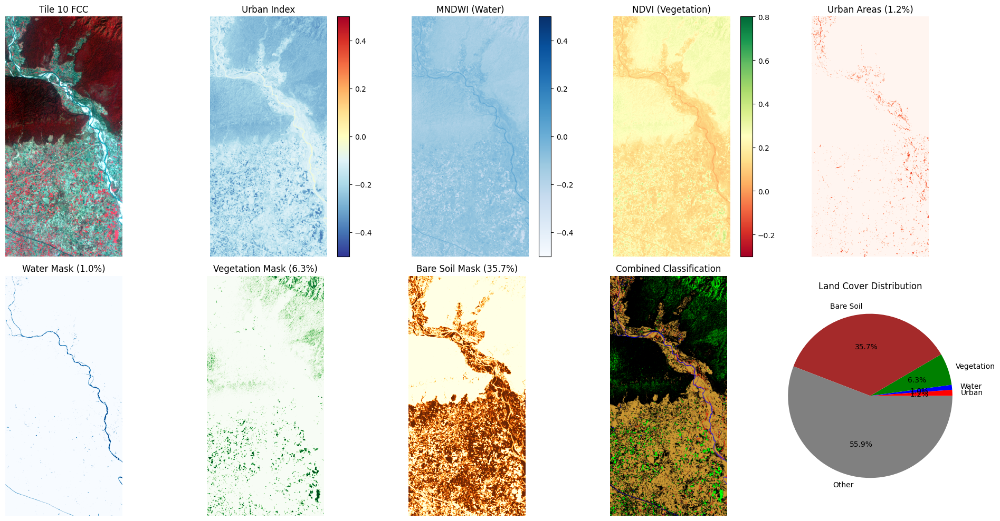


Tile 10 Statistics:
  Urban: 1.2%
  Water: 1.0%
  Vegetation: 6.3%
  Bare Soil: 35.7%
  Other: 55.9%


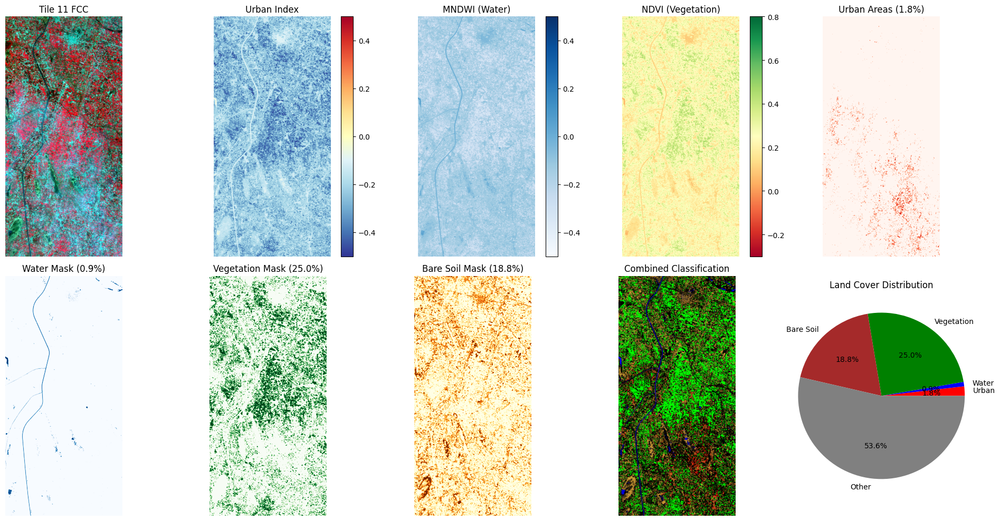


Tile 11 Statistics:
  Urban: 1.8%
  Water: 0.9%
  Vegetation: 25.0%
  Bare Soil: 18.8%
  Other: 53.6%


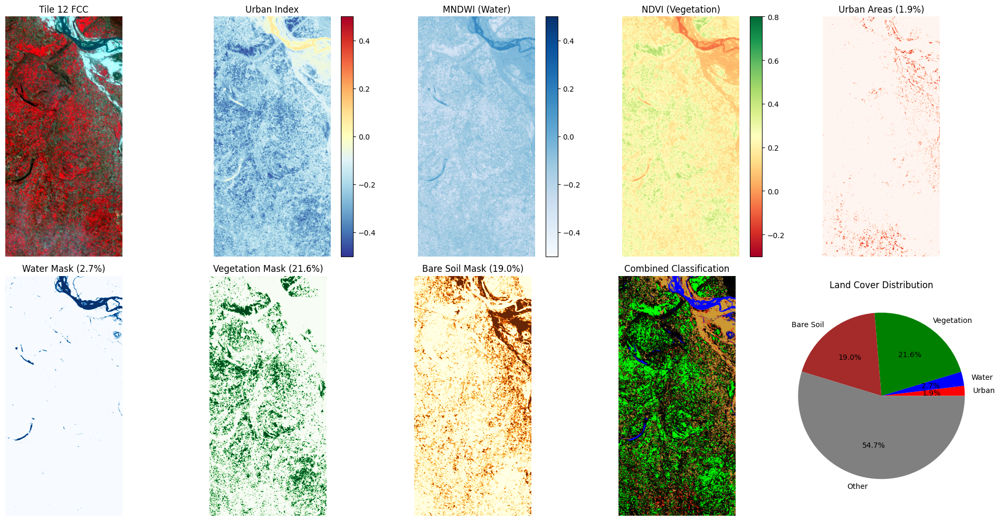


Tile 12 Statistics:
  Urban: 1.9%
  Water: 2.7%
  Vegetation: 21.6%
  Bare Soil: 19.0%
  Other: 54.7%


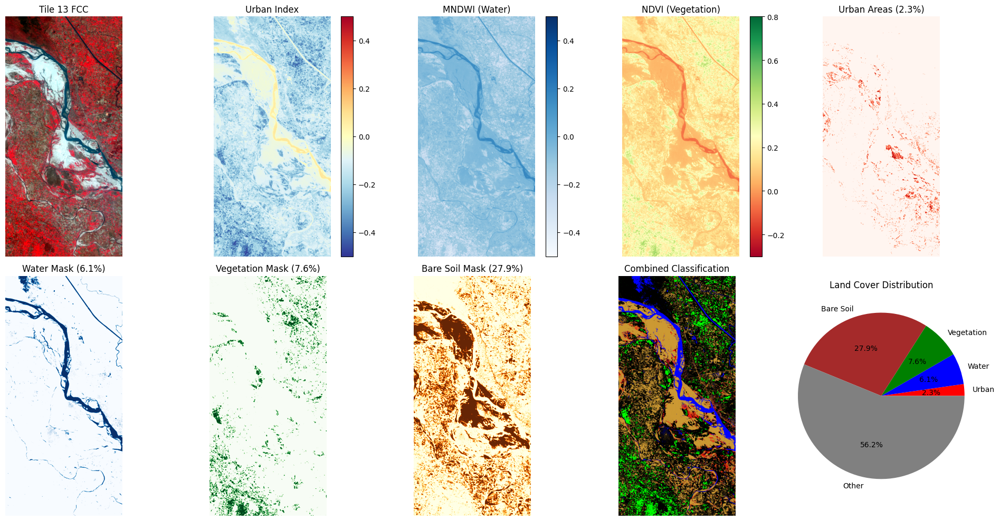


Tile 13 Statistics:
  Urban: 2.3%
  Water: 6.1%
  Vegetation: 7.6%
  Bare Soil: 27.9%
  Other: 56.2%


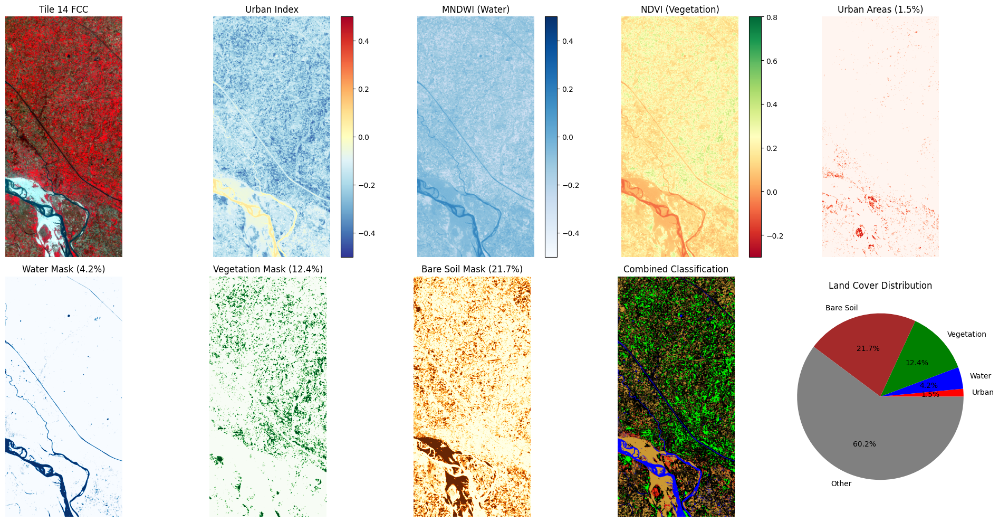


Tile 14 Statistics:
  Urban: 1.5%
  Water: 4.2%
  Vegetation: 12.4%
  Bare Soil: 21.7%
  Other: 60.2%


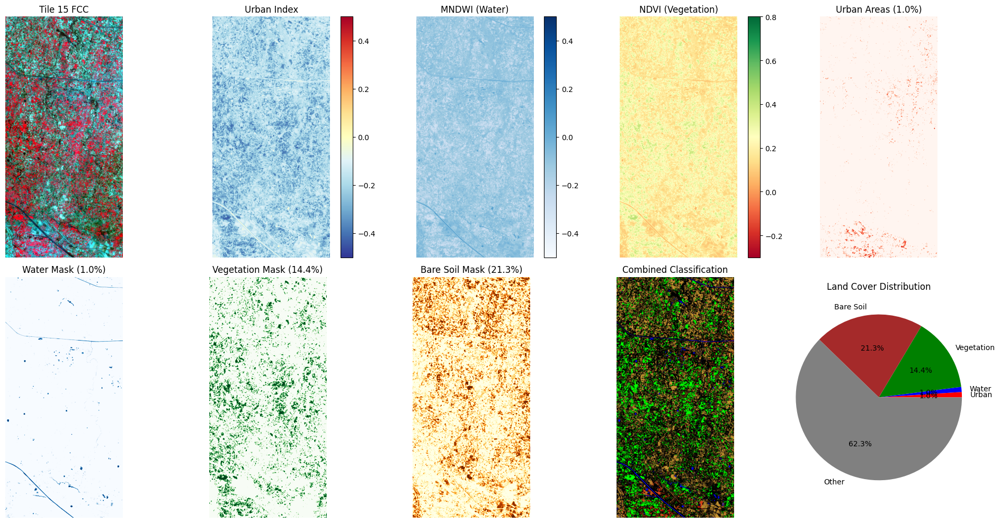


Tile 15 Statistics:
  Urban: 1.0%
  Water: 1.0%
  Vegetation: 14.4%
  Bare Soil: 21.3%
  Other: 62.3%


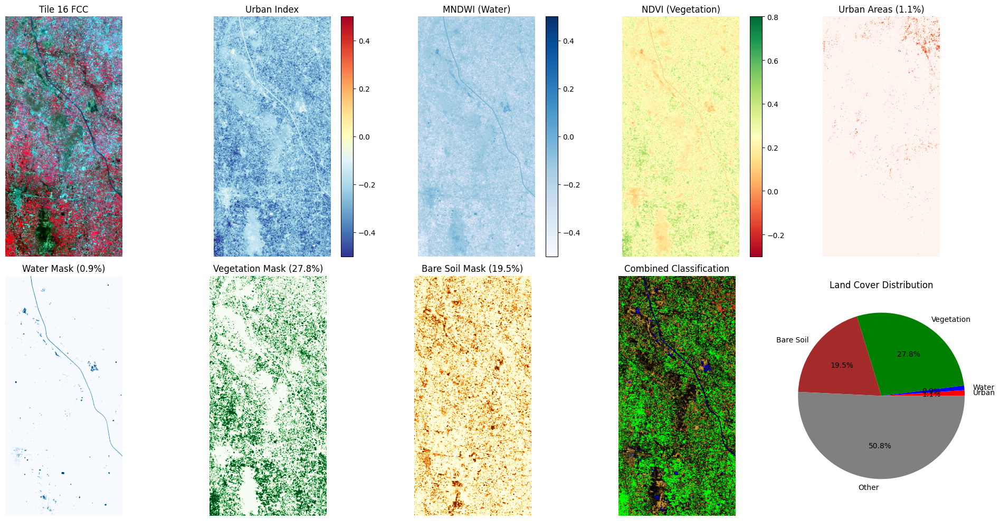


Tile 16 Statistics:
  Urban: 1.1%
  Water: 0.9%
  Vegetation: 27.8%
  Bare Soil: 19.5%
  Other: 50.8%


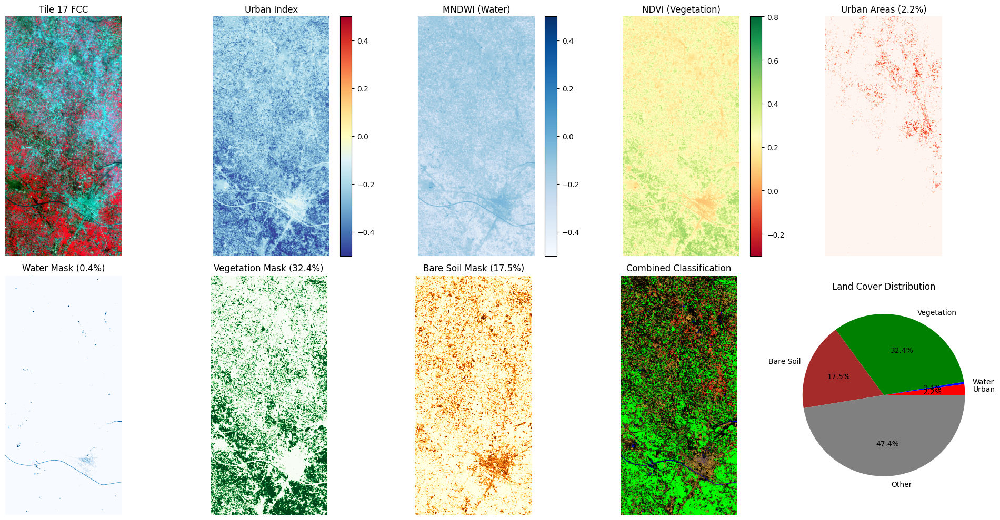


Tile 17 Statistics:
  Urban: 2.2%
  Water: 0.4%
  Vegetation: 32.4%
  Bare Soil: 17.5%
  Other: 47.4%


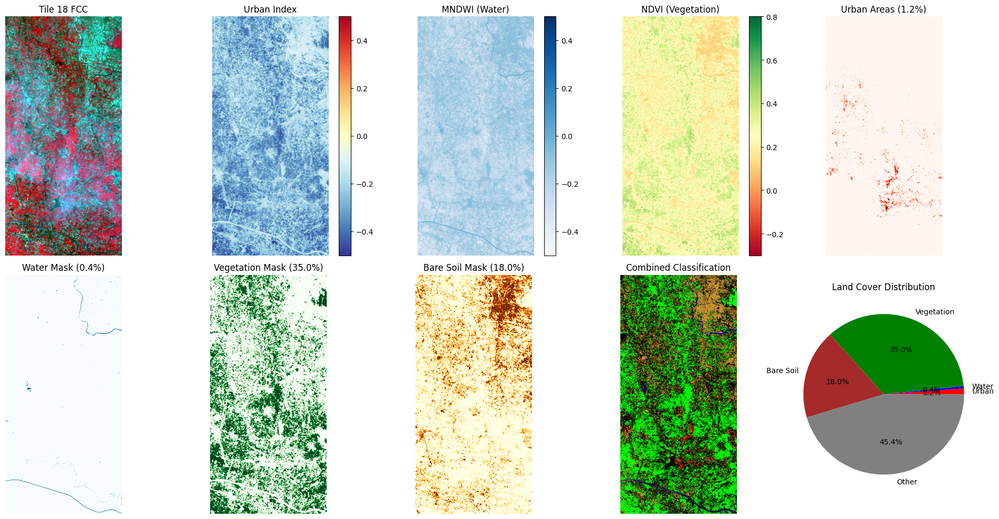


Tile 18 Statistics:
  Urban: 1.2%
  Water: 0.4%
  Vegetation: 35.0%
  Bare Soil: 18.0%
  Other: 45.4%


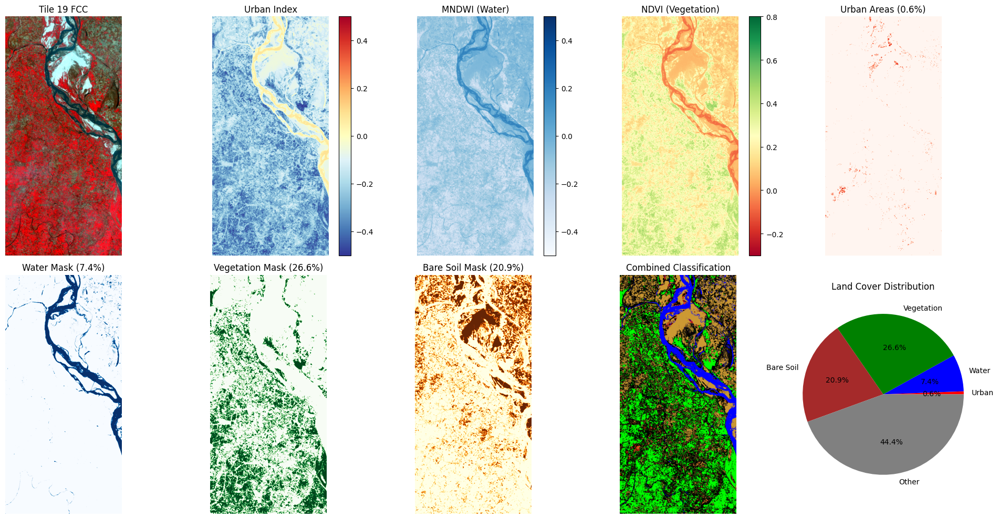


Tile 19 Statistics:
  Urban: 0.6%
  Water: 7.4%
  Vegetation: 26.6%
  Bare Soil: 20.9%
  Other: 44.4%


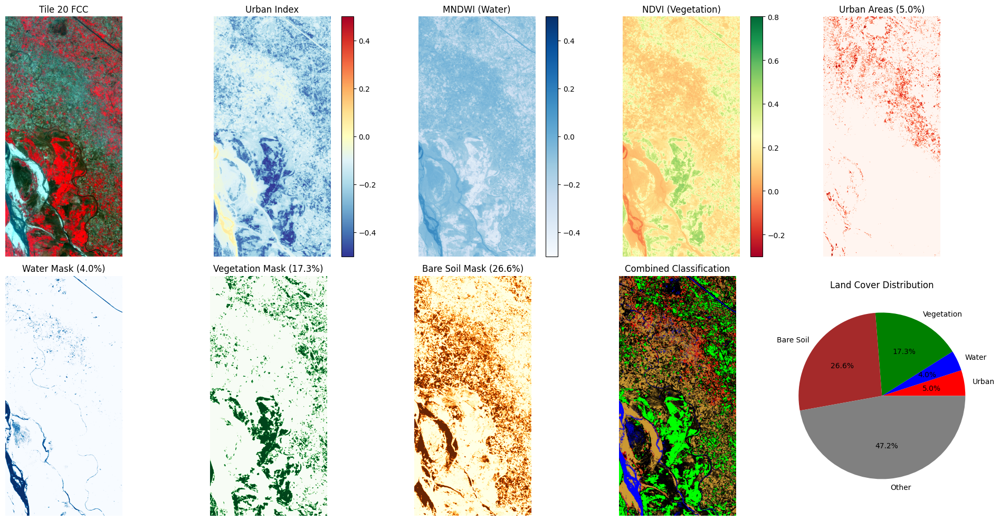


Tile 20 Statistics:
  Urban: 5.0%
  Water: 4.0%
  Vegetation: 17.3%
  Bare Soil: 26.6%
  Other: 47.2%

URBAN AREA DETECTION SUMMARY
Average Urban Percentage: 1.33%
Maximum Urban Percentage: 4.98%
Minimum Urban Percentage: 0.02%
Standard Deviation: 1.08%

Top 5 Most Urban Tiles:
1. Tile 20: 5.0% urban at coordinates (11220, 11350, 13000, 15000)
2. Tile 13: 2.3% urban at coordinates (7660, 7700, 9440, 11350)
3. Tile 1: 2.2% urban at coordinates (4100, 400, 5880, 4050)
4. Tile 17: 2.2% urban at coordinates (5880, 11350, 7660, 15000)
5. Tile 12: 1.9% urban at coordinates (5880, 7700, 7660, 11350)

Top 5 Least Urban Tiles:
1. Tile 19: 0.6% urban at coordinates (9440, 11350, 11220, 15000)
2. Tile 5: 0.4% urban at coordinates (11220, 400, 13000, 4050)
3. Tile 2: 0.2% urban at coordinates (5880, 400, 7660, 4050)
4. Tile 8: 0.1% urban at coordinates (7660, 4050, 9440, 7700)
5. Tile 3: 0.0% urban at coordinates (7660, 400, 9440, 4050)


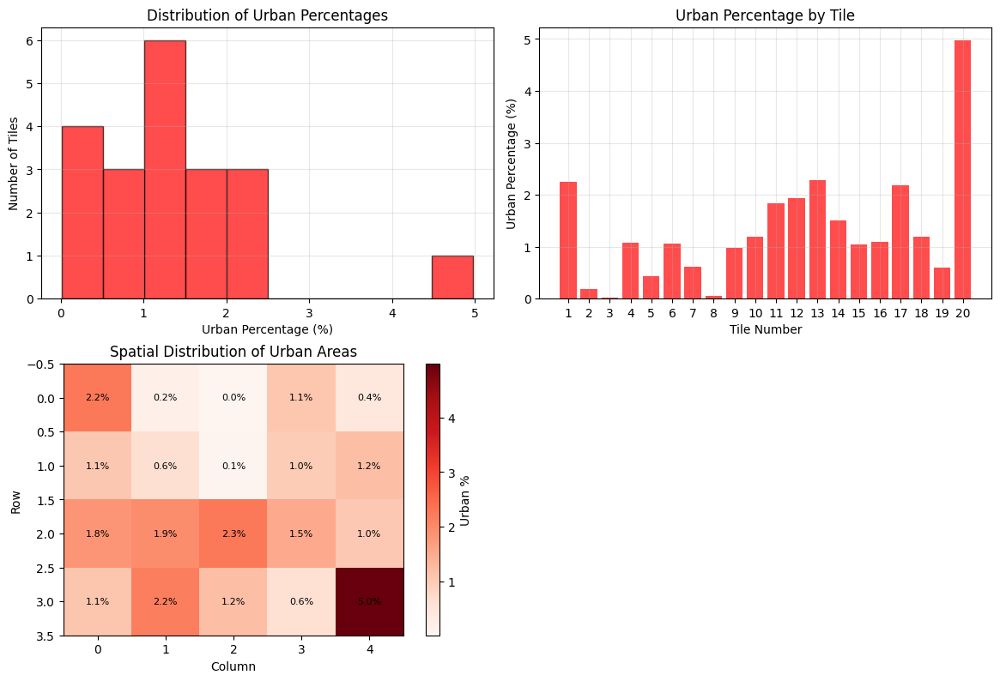

In [5]:
import rasterio
import numpy as np
from skimage.morphology import remove_small_objects
import matplotlib.pyplot as plt
import math
from skimage.filters import threshold_otsu

def load_liss4_band(path):
    """Load and properly scale LISS-IV band (10-bit or 12-bit)"""
    with rasterio.open(path) as src:
        band = src.read(1)
        # Check if data is 10-bit (0-1023) or 12-bit (0-4095)
        max_val = 1023 if band.max() <= 1023 else 4095
        return band.astype('float32') / max_val

# Load bands
green = load_liss4_band('BAND2.tif')  # Green (0.52-0.59µm)
red = load_liss4_band('BAND3.tif')    # Red (0.62-0.68µm)
nir = load_liss4_band('BAND4.tif')    # NIR (0.77-0.86µm)

# Validate band ranges
full_height, full_width = green.shape
print(f"Full image dimensions: {full_height} x {full_width}")
print("\nBand value ranges after scaling:")
print(f"Green: {green.min():.4f} to {green.max():.4f}")
print(f"Red: {red.min():.4f} to {red.max():.4f}")
print(f"NIR: {nir.min():.4f} to {nir.max():.4f}")

# Define ROI
x_start, x_end = 4100, 13000
y_start, y_end = 400, 15000

# Validate coordinates
x_start = max(0, min(x_start, full_width))
x_end = max(x_start, min(x_end, full_width))
y_start = max(0, min(y_start, full_height))
y_end = max(y_start, min(y_end, full_height))

print(f"\nRegion of Interest: x({x_start}-{x_end}), y({y_start}-{y_end})")

# Extract ROI
green_roi = green[y_start:y_end, x_start:x_end]
red_roi = red[y_start:y_end, x_start:x_end]
nir_roi = nir[y_start:y_end, x_start:x_end]

roi_height, roi_width = green_roi.shape
print(f"ROI dimensions: {roi_height} x {roi_width}")

def enhanced_urban_detection(green_tile, red_tile, nir_tile, min_size=10):
    """
    Urban area detection for LISS-IV with:
    - Urban Index (UI) calculation
    - NDWI for water removal
    - NDVI for vegetation removal
    - Bare soil removal
    - Dynamic thresholding
    """
    # Calculate indices
    urban_index = (red_tile - nir_tile) / (red_tile + nir_tile + 1e-10)
    ndbi = (red_tile - nir_tile) / (red_tile + nir_tile + 1e-10)
    ndwi = (green_tile - nir_tile) / (green_tile + nir_tile + 1e-10)
    ndvi = (nir_tile - red_tile) / (nir_tile + red_tile + 1e-10)
    
    # Calculate Bare Soil Index (BSI)
    bsi = ((red_tile + nir_tile) - (nir_tile + green_tile)) / ((red_tile + nir_tile) + (nir_tile + green_tile) + 1e-10)
    
    # Dynamic thresholds
    try:
        urban_thresh = threshold_otsu(urban_index[(urban_index > -1) & (urban_index < 1)]) * 0.7
        water_thresh = threshold_otsu(ndwi[(ndwi > -1) & (ndwi < 1)]) * 0.1
        veg_thresh = 0.3
        bsi_thresh = threshold_otsu(bsi[(bsi > -1) & (bsi < 1)]) * 0.8
    except:
        urban_thresh = 0.1
        water_thresh = 0.1
        veg_thresh = 0.3
        bsi_thresh = 0.2
    
    # Create masks
    urban_mask = urban_index > urban_thresh
    water_mask = ndwi > water_thresh
    vegetation_mask = ndvi > veg_thresh
    bare_soil_mask = bsi > bsi_thresh
    
    # Refine urban mask by removing water, vegetation, and bare soil
    urban_final = urban_mask & (~water_mask) & (~vegetation_mask) & (~bare_soil_mask)
    
    # Additional brightness filter for urban areas
    brightness = (red_tile + green_tile + nir_tile) / 3
    brightness_thresh = np.percentile(brightness, 40)
    urban_final = urban_final & (brightness > brightness_thresh)
    
    # Remove small objects
    urban_final = remove_small_objects(urban_final, min_size=min_size)
    
    return urban_final, urban_index, ndwi, ndvi, water_mask, bare_soil_mask

def scale_for_display(img, percentile=98):
    """Enhanced contrast stretching for visualization"""
    img = np.nan_to_num(img, nan=0.0)
    if np.sum(img > 0) == 0:
        return img
    p2, p98 = np.percentile(img[img > 0], (2, percentile))
    if p98 == p2:
        return img
    return np.clip((img - p2) / (p98 - p2), 0, 1)

# Process tiles
rows, cols = 4, 5
tile_height = roi_height // rows
tile_width = roi_width // cols

urban_percentages = []
tile_info = []

# Main processing loop
for i in range(rows):
    for j in range(cols):
        tile_idx = i * cols + j + 1
        
        # Extract tile
        y1, y2 = i * tile_height, (i + 1) * tile_height
        x1, x2 = j * tile_width, (j + 1) * tile_width
        green_tile = green_roi[y1:y2, x1:x2]
        red_tile = red_roi[y1:y2, x1:x2]
        nir_tile = nir_roi[y1:y2, x1:x2]
        
        # Detect urban areas - now unpacking 6 values
        urban_mask, urban_index, mndwi, ndvi, water_mask, bare_soil_mask = enhanced_urban_detection(green_tile, red_tile, nir_tile)
        urban_pct = np.sum(urban_mask) / urban_mask.size * 100
        
        # Store results
        urban_percentages.append(urban_pct)
        tile_info.append({
            'tile': tile_idx,
            'urban_pct': urban_pct,
            'coords': (x_start + x1, y_start + y1, x_start + x2, y_start + y2)
        })
        
        # Visualization
        fcc = np.dstack((scale_for_display(nir_tile), 
                        scale_for_display(red_tile), 
                        scale_for_display(green_tile)))
        
        plt.figure(figsize=(20, 10))
        
        # Row 1: Original data and indices
        plt.subplot(2, 5, 1)
        plt.imshow(fcc)
        plt.title(f'Tile {tile_idx} FCC')
        plt.axis('off')
        
        plt.subplot(2, 5, 2)
        plt.imshow(urban_index, cmap='RdYlBu_r', vmin=-0.5, vmax=0.5)
        plt.title('Urban Index')
        plt.colorbar()
        plt.axis('off')
        
        plt.subplot(2, 5, 3)
        plt.imshow(mndwi, cmap='Blues', vmin=-0.5, vmax=0.5)
        plt.title('MNDWI (Water)')
        plt.colorbar()
        plt.axis('off')
        
        plt.subplot(2, 5, 4)
        plt.imshow(ndvi, cmap='RdYlGn', vmin=-0.3, vmax=0.8)
        plt.title('NDVI (Vegetation)')
        plt.colorbar()
        plt.axis('off')
        
        plt.subplot(2, 5, 5)
        plt.imshow(urban_mask, cmap='Reds')
        plt.title(f'Urban Areas ({urban_pct:.1f}%)')
        plt.axis('off')
        
        # Row 2: Individual masks
        veg_mask = ndvi > 0.3
        
        plt.subplot(2, 5, 6)
        plt.imshow(water_mask, cmap='Blues')
        plt.title(f'Water Mask ({np.sum(water_mask)/water_mask.size*100:.1f}%)')
        plt.axis('off')
        
        plt.subplot(2, 5, 7)
        plt.imshow(veg_mask, cmap='Greens')
        plt.title(f'Vegetation Mask ({np.sum(veg_mask)/veg_mask.size*100:.1f}%)')
        plt.axis('off')
        
        plt.subplot(2, 5, 8)
        plt.imshow(bare_soil_mask, cmap='YlOrBr')
        plt.title(f'Bare Soil Mask ({np.sum(bare_soil_mask)/bare_soil_mask.size*100:.1f}%)')
        plt.axis('off')
        
        # Combined overlay
        plt.subplot(2, 5, 9)
        overlay = np.zeros((*urban_mask.shape, 3))
        overlay[urban_mask] = [1, 0, 0]      # Red for urban
        overlay[water_mask] = [0, 0, 1]      # Blue for water  
        overlay[veg_mask] = [0, 1, 0]        # Green for vegetation
        overlay[bare_soil_mask] = [0.8, 0.6, 0.2]  # Brown for bare soil
        plt.imshow(overlay)
        plt.title('Combined Classification')
        plt.axis('off')
        
        # Statistics
        plt.subplot(2, 5, 10)
        labels = ['Urban', 'Water', 'Vegetation', 'Bare Soil', 'Other']
        sizes = [
            np.sum(urban_mask)/urban_mask.size*100,
            np.sum(water_mask)/water_mask.size*100,
            np.sum(veg_mask)/veg_mask.size*100,
            np.sum(bare_soil_mask)/bare_soil_mask.size*100,
            100 - (np.sum(urban_mask) + np.sum(water_mask) + np.sum(veg_mask) + np.sum(bare_soil_mask))/urban_mask.size*100
        ]
        colors = ['red', 'blue', 'green', 'brown', 'gray']
        plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%')
        plt.title('Land Cover Distribution')
        
        plt.tight_layout()
        plt.show()
        
        # Print detailed statistics for this tile
        print(f"\nTile {tile_idx} Statistics:")
        print(f"  Urban: {sizes[0]:.1f}%")
        print(f"  Water: {sizes[1]:.1f}%")
        print(f"  Vegetation: {sizes[2]:.1f}%")
        print(f"  Bare Soil: {sizes[3]:.1f}%")
        print(f"  Other: {sizes[4]:.1f}%")

# Summary statistics
print("\n" + "="*50)
print("URBAN AREA DETECTION SUMMARY")
print("="*50)
print(f"Average Urban Percentage: {np.mean(urban_percentages):.2f}%")
print(f"Maximum Urban Percentage: {np.max(urban_percentages):.2f}%")
print(f"Minimum Urban Percentage: {np.min(urban_percentages):.2f}%")
print(f"Standard Deviation: {np.std(urban_percentages):.2f}%")

# Sort tiles by urban percentage
sorted_tiles = sorted(tile_info, key=lambda x: x['urban_pct'], reverse=True)
print("\nTop 5 Most Urban Tiles:")
for i, tile in enumerate(sorted_tiles[:5], 1):
    print(f"{i}. Tile {tile['tile']}: {tile['urban_pct']:.1f}% urban at coordinates {tile['coords']}")

print("\nTop 5 Least Urban Tiles:")
for i, tile in enumerate(sorted_tiles[-5:], 1):
    print(f"{i}. Tile {tile['tile']}: {tile['urban_pct']:.1f}% urban at coordinates {tile['coords']}")

# Create summary visualization
plt.figure(figsize=(12, 8))
plt.subplot(2, 2, 1)
plt.hist(urban_percentages, bins=10, color='red', alpha=0.7, edgecolor='black')
plt.xlabel('Urban Percentage (%)')
plt.ylabel('Number of Tiles')
plt.title('Distribution of Urban Percentages')
plt.grid(True, alpha=0.3)

plt.subplot(2, 2, 2)
tile_numbers = [info['tile'] for info in tile_info]
plt.bar(tile_numbers, urban_percentages, color='red', alpha=0.7)
plt.xlabel('Tile Number')
plt.ylabel('Urban Percentage (%)')
plt.title('Urban Percentage by Tile')
plt.xticks(tile_numbers)
plt.grid(True, alpha=0.3)

# Spatial distribution of urban areas
plt.subplot(2, 2, 3)
urban_grid = np.array(urban_percentages).reshape(rows, cols)
im = plt.imshow(urban_grid, cmap='Reds', interpolation='nearest')
plt.colorbar(im, label='Urban %')
plt.title('Spatial Distribution of Urban Areas')
plt.xlabel('Column')
plt.ylabel('Row')

# Add text annotations
for i in range(rows):
    for j in range(cols):
        plt.text(j, i, f'{urban_grid[i,j]:.1f}%', 
                ha='center', va='center', fontsize=8)

plt.tight_layout()
plt.show()